# An Exploration of Analysis Methods on Predictive Models of Student Success

### Alex Beckwith
### May 2023

## Presentation Itinerary
- Introduction
    - Presentation Itinerary
    - Quick Summary
- Motivations
    - Personal Goals
    - Research Goals
    - Research Questions
- Previous Research
    - Learning Analytics/Education Data Mining
    - Predicting Student Performance
    - Model Evaluation Methods

- Experimental Architecture
    - Dataset
    - Feature Extraction
    - Algorithms & Hyperparameters
    - Model Pipeline
- Model Evaluation
    - Naive Averaging
    - Null Hypothesis Significance Testing (NHST)
    - Bayesian
    - Future Research
- Wrap Up
    - Questions
    - Tools Used
    - Top References

## Quick Summary

- Built a system to train, test, & evaluate machine learning models
- Applied to educational data from an online university
- Used system to generate predictions
- Analyzed results

### Abstract 

Machine learning models are not always evaluated with statistical rigor. This can lead to inferential flaws when assumptions are made about the underlying and performance data, especially when cross-validation is used. In this paper, a Bayesian method of model evaluation is compared to a non-parametric frequentist method. In addition, a metric for analyzing the fairness of a particular algorithm is tested. 

The evaluation techniques were applied to a dataset of student and course data made available by the Open University. A system was built to train and test predictive models of student success. The aim was to predict students at risk of failing or withdrawing from a course using the first 30 days of data extracted from the virtual learning environment. In an applied setting, these predictions could be used to direct additional resources to at-risk students. 

The project included creating a database to cleanse, transform, and analyze the dataset. Features were engineered to use as predictive inputs using a combination of exploratory analysis and inspiration from research. Four different subsets of input features were applied to nine different classification algorithms. Both randomized and exhaustive hyperparameter tuning procedures were experimented with, which created hundreds of distinct hyperparameter settings.  

The Bayesian strategy provided more conclusive results by determining a “region of practical equivalence” as opposed to an inability to reject the null hypothesis. The results were similar to findings from research, which typically had tree-based ensemble methods in the upper-equivalence region. 

The proposed metric for predictive fairness is called the Absolute Between Receiver Operating Characteristic Area (ABROCA). This metric was first introduced at the 2019 International Learning Analytics & Knowledge Conference. A significant relationship between ABROCA and the gender ratio of a course as well as between ABROCA and the ratio of students in a course identifying as having a disability. No significant relationship was found between ABROCA and overall model performance. 

In [1]:
from os import environ

import seaborn as sns
from db_helpers import DbHelper, Table
from IPython.display import Image

# imports
from matplotlib import pyplot as plt

from model.params import Params
from utils import pathsearch

In [2]:
def get_params(mtype: str, is_rand: bool = True, n: int = 1, _print: bool = True):
    if is_rand:
        stype = "RandomizedSearch Cross-Validation"
    else:
        stype = "GridSearch Cross-Validation"
    if _print:
        print(f"Example of {stype} for {mtype}:")
    environ["SEARCH_RANDOM"] = str(is_rand)
    params = Params(model_type=mtype).get_param_gen()
    for _i in range(n):
        try:
            gs_params = next(params)._dict
        except StopIteration:
            gs_params = next(Params(model_type=mtype).get_param_gen())._dict

        for key in list(gs_params.keys()):
            print(key, gs_params[key])
        print("\n")

In [3]:
dbh = DbHelper("LOCAL")
features = Table("LOCAL", "first30", "all_features")
sns.set_theme(style="whitegrid")
figures = pathsearch("figures")
logos = figures / "logos"
logo_val = 300
demog_val = 500
full_val = 800
xl = 1000
logo_wh = {"width": logo_val, "height": logo_val}
demog_wh = {"width": demog_val, "height": demog_val}
full_wh = {"width": full_val, "height": full_val}
xl_wh = {"width": xl, "height": xl}

In [5]:
df = dbh.get_table("main", "v_vs_staging_demog")
df.loc[:, "imd_band"] = df.loc[:, "imd_band"].apply(
    lambda x: "10-20%" if x == "10-20" else x
)
df.head()

,id,module_code,presentation_code,age_band,imd_band,highest_education,region,is_female,has_disability,final_result,source
0,32588,DDD,2013J,55<=,90-100%,HE Qualification,South Region,0,0,Withdrawn,main
1,22291,AAA,2014J,55<=,80-90%,HE Qualification,Scotland,0,0,Pass,main
2,32538,DDD,2014J,55<=,30-40%,HE Qualification,London Region,0,0,Withdrawn,main
3,32539,DDD,2013J,55<=,30-40%,HE Qualification,London Region,0,0,Withdrawn,main
4,22281,AAA,2013J,55<=,90-100%,HE Qualification,East Anglian Region,0,0,Pass,main


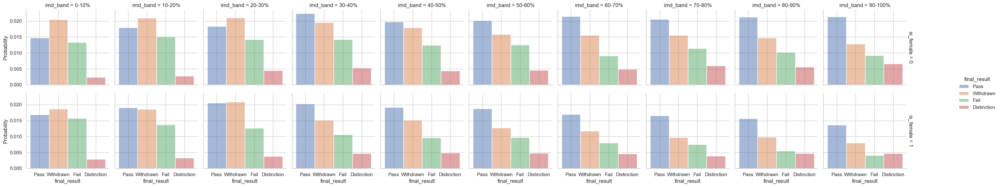

In [6]:
cm = sns.color_palette("Spectral", n_colors=4)
ax = sns.displot(
    df.sort_values("module_code"),
    x="final_result",
    col="imd_band",
    # row="source",
    # row="source",
    row="is_female",
    hue="final_result",
    col_order=[f"{k}-{k+10}%" for k in range(0, 100, 10)],
    binwidth=1,
    height=3,
    # palette=cm,
    # hue_order=["Withdrawn", "Fail", "Pass", "Distinction"],
    facet_kws={"margin_titles": True},
    # multiple="stack",
    # stat="percent",
    # common_bins=False,
    # common_norm=False,
    stat="probability",
)

In [7]:
df = features.df.loc[:, ["final_result", "n_days_active", "student_id"]]
gb = df.groupby(["n_days_active", "final_result"]).count().reset_index()
gb[gb.loc[:, "n_days_active"].apply(lambda x: x in list(range(27, 31)))]

,n_days_active,final_result,student_id
100,27,Distinction,39
101,27,Fail,102
102,27,Pass,160
103,27,Withdrawn,95
104,28,Distinction,28
105,28,Fail,75
106,28,Pass,152
107,28,Withdrawn,88
108,29,Distinction,26
109,29,Fail,83


avg_days_before_due_submitted
var_days_before_due_submitted
stddev_days_before_due_submitted
skew_days_before_due_submitted
kurt_days_before_due_submitted
min_days_before_due_submitted
max_days_before_due_submitted
n_days_active


<Axes: xlabel='min_days_before_due_submitted', ylabel='Count'>

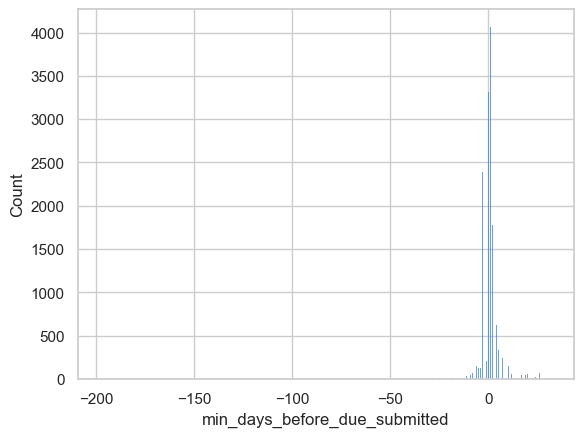

In [8]:
df = features.df
for x in [y for y in df.columns if "days" in y]:
    print(x)
sns.histplot(df, x="min_days_before_due_submitted")

In [9]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9), dpi=800)
sns.histplot(
    df,
    x="n_days_active",
    hue="final_result",
    hue_order=["Distinction", "Pass", "Fail", "Withdrawn"],
    ax=ax,
    multiple="stack",
    bins=max(gb.loc[:, "student_id"]),
    binwidth=1,
)
# figsave("n_days_active")

<Axes: xlabel='n_days_active', ylabel='Count'>

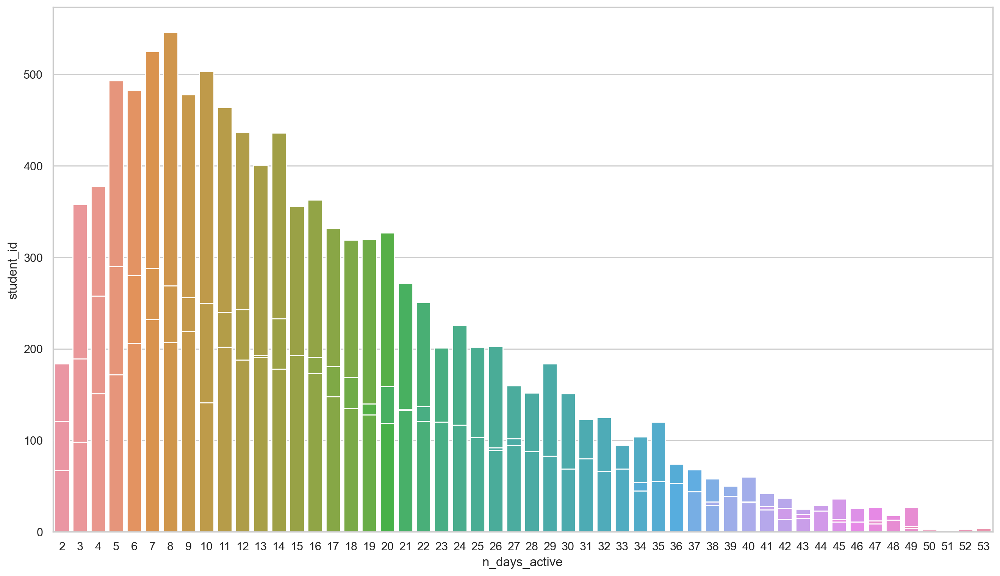

In [10]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9), dpi=200)

cp = sns.color_palette("flare", n_colors=4)
for _i, x in enumerate(["Distinction", "Pass", "Fail", "Withdrawn"]):
    sns.barplot(
        gb[gb.loc[:, "final_result"] == x],
        x="n_days_active",
        y="student_id",
        # hue="final_result",
        # hue_order=["Distinction", "Pass", "Fail", "Withdrawn"],
        ax=ax,
        # multiple="stack",
        # bins=20,
    )

In [11]:
def show_tbl(
    schema: str,
    table: str,
    nrows: int = 10,
    dbh: DbHelper = dbh,
):
    print(f"Showing {nrows} rows from {schema}.{table}")
    return dbh.get_table(schema, table, nrows=nrows)

# Motivations

## Personal Goals
- Research personally relevant topic (education) 
- Apply knowledge of SQL/Python/data from job as data analyst 
- Apply interest/knowledge of predictive models learned independently and in data science program
- Increase knowledge of statistical evaluation methods

## Research Goals
- Evaluate machine learning models using best practices/methods/tooling
- Determine if Bayesian or Frequentist methods are better for machine learning problems
- Test new metric for evaluation of model fairness
- Apply above goals to case study with education dataset

## Research Questions
1. Which models and featuresets are best at predicting student outcomes?
2. How do the results differ when models are compared using naive, frequentist and Bayesian methods? 
3. Is there an association between model predictive performance and Absolute Between Receiver Operating Characteristic Area (ABROCA)?

# Previous Research

## Learning Analytics/Education Data Mining

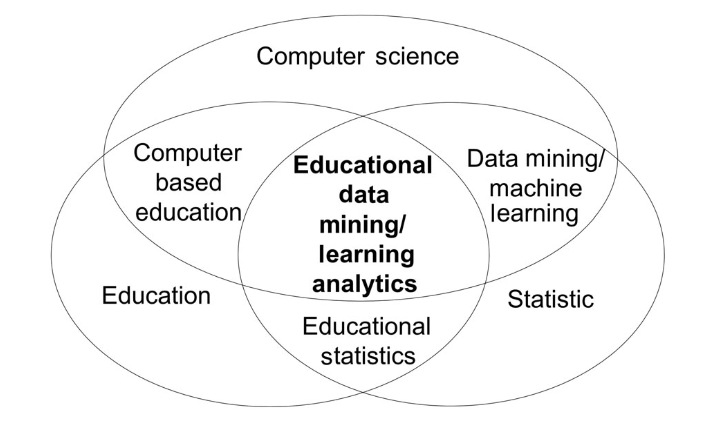

In [12]:
Image(figures / "edm.png", **demog_wh)

- Educational Data Mining (EDM) is concerned with developing methods for exploring the unique types of data that come from educational environments
        - It can be also defined as the application of data mining (DM) techniques to this specific type of dataset that come from educational environments to address important educational questions.
- Learning Analytics (LA) can be defined as the measurement, collection, analysis, and reporting of data about learners and their contexts, for purposes of understanding and optimizing learning and the environments in which it occurs (Lang, Siemens, Wise, & Gasevic, 2017). There are three crucial elements involved in this definition data, analysis and action.
Educational data mining and learning analytics: An updated survey
Cristobal Romero | Sebastian Ventura

## Predicting Student Performance

- Within EDM/LA, looked speifically at predicting student performance
- Important to:
    - detect early to divert resources to students in need
    - Trace knowledge transfer

### Most common types of prediction:
1. Classification
2. Regression
3. Clustering

### Common Predictions:
1. Final outcome
    - Dropout
    - Pass/Fail
2. Final grades
3. Deadline compliance

### Most common algorithms:
1. Tree-based
    - Decision Tree
    - Random Forest
    - Boosted
2. Regression
    - Logistic Regression
    - Linear Regression
4. Support Vector Machines
5. Bayesian
    - Naive Bayes
6. K-Nearest-Neighbor
7. Artificial Neural Networks

- best performing are typically ensemble methods

### Most common student data sources:
1. Computer-based learning environment
    - Massive Open Online Course (MOOCs)
    - Intelligent Tutoring Systems (ITS)
    - Learning Management System
2. In-person

Online -> 
    More data available
    data more consistent
Blended learning needs more study

### Most common feature types:
1. Academic data
    - Assessments
2. Demographic data
3. Behavior
    - Virtual learning environment (VLE) interactions
4. Financial aid data

### Feature Extraction Strategy
- Automated vs Expert Engineered vs Crowdsourced
- Automated can perform better, but often less interpretable

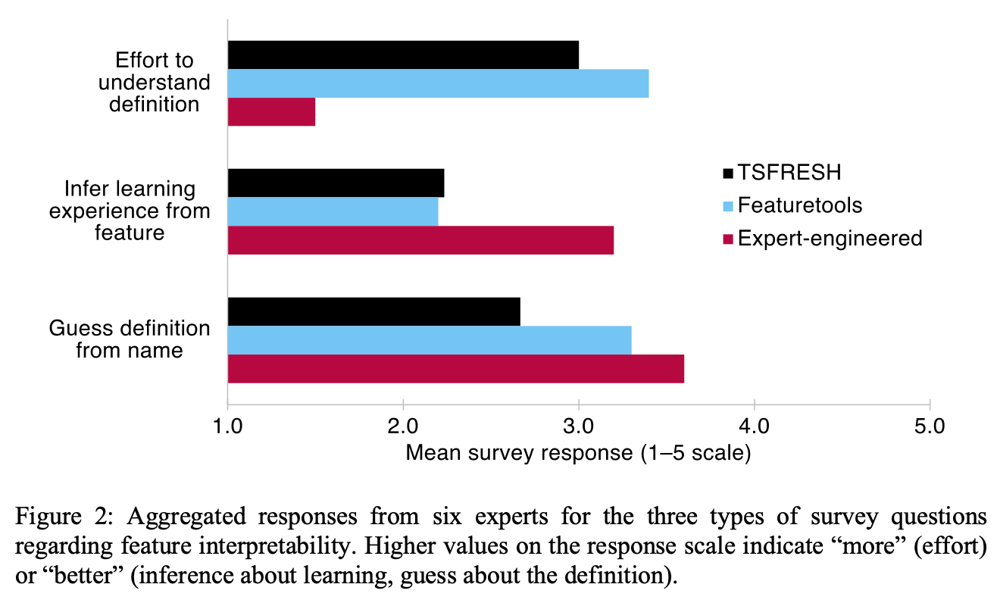

In [13]:
Image(figures / "auto_fe.png", **demog_wh)

- AutoML Feature Engineering for Student Modeling Yields High Accuracy, but Limited Interpretability
- Nigel Bosch - University of Illinois Urbana-Champaign
- TSFRESH performed better than both, but was most difficult to interpret
- (Time Series FeatuRe Extraction on basis of Scalable Hypothesis tests)
- Another source suggested crowdsourcing features in addition to 

## Model Evaluation Methods

### Naive Averaging
- Sorting and picking top average value
- Hard to extrapolate

- Simply sorting by metric and picking top value
- Difficult to discern differences between models
- No sense of variability between model types/settings
- Tough to weigh other factors like interpretability & fit time in justified way

### Frequentist (Null Hypothesis Significance Testing)

Critical difference diagram based on results from post-hoc Nemenyi tests:


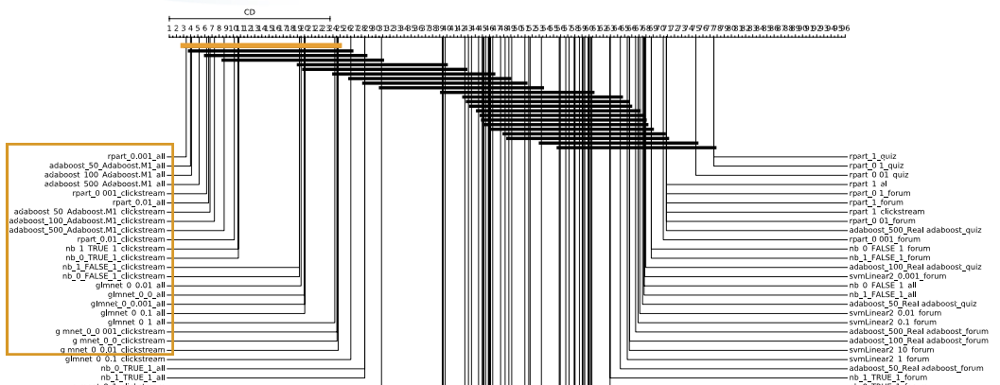

In [14]:
# Single Dataset ROPE Example
print("Critical difference diagram based on results from post-hoc Nemenyi tests:")
Image(figures / "nemenyi_critical_dif.png", **full_wh)

diagram shows regions for which the null hypothesis cannot be rejected
- Friedman test to show whether groups of results are similar (global test)
- Post-hoc Nemenyi Test to indicate if significant difference exists between two models
- Tough to compare large set of models in this way
- Used non-parametric tests to minimize assumptions of distributions of model data
- Better for model output data

### Bayesian

Output from Signed Rank Test


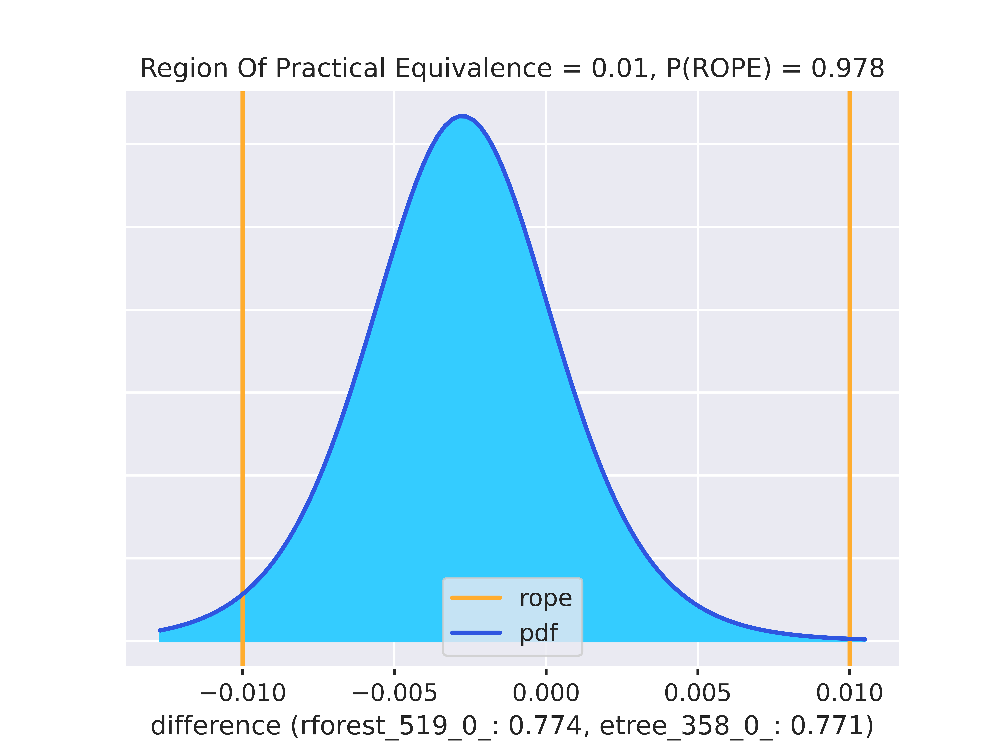

In [15]:
# Single Dataset ROPE Example
print("Output from Signed Rank Test")
Image(figures / "rope_rforest_519_0__etree_358_0_.png", **demog_wh)

- Uses Bayesian signed rank test to estimate probability of means being in a prespecified "Region of Practical Equivalence" (ROPE)
- This test used a ROPE vaue of 0.01, indicating that a 1% difference in means is a wide enough band to consider the performance of two models equivalent for all practical purposes

Output from test on multiple datasets:


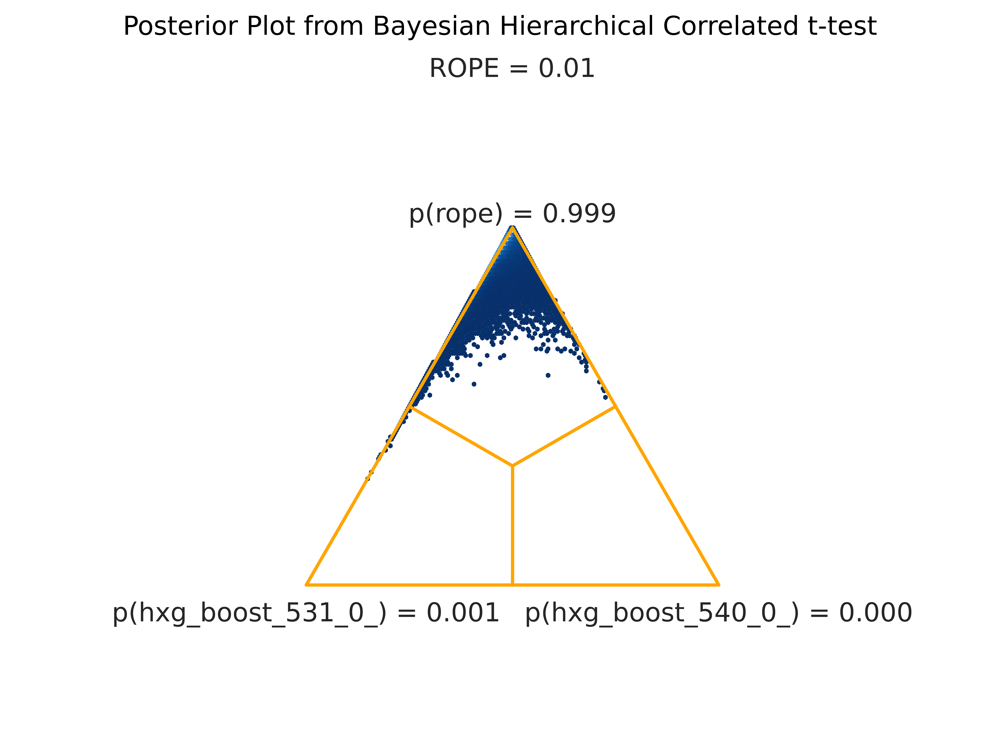

In [16]:
# Multiple Dataset ROPE Example:
print("Output from test on multiple datasets:")
Image(figures / "rope_on_two_hxg_boost_531_0__hxg_boost_540_0_.png", **demog_wh)

- A Bayesian posterior plot resulting from a Bayesian hierarchical correlated t-test
- visualizes the results of Markov-Chain Monte Carlo (MCMC) sampling for the comparison of two models X and Y
- The estimated probability of each outcome is the proportion of samples that fall in each section of the plot.
- "heavier" than signed rank test, so less convenient
- baycomp uses hierarchical for multiple datasets, signed rank for single

## ABROCA | Slicing Analysis
### (Absolute Between Receiver Operating Characteristic Area)

### Receiver Operating Characteristic (ROC Curve)
- A function of the false positive rate to true positive rate over the range of threshold values for a predictor
- Area under ROC curve (ROC AUC) commonly used as metric to optimize performance of machine learning models.
    - Perfect predictor -> ROC AUC = $1.0$ (correct prediction at all threshold values)
    - Random predictor -> ROC AUC = $0.5$ (equally likely to pick correctly or incorrectly at all threshold values) 
- <a href="https://core.ac.uk/download/pdf/55142552.pdf">Link to more math</a>

In [17]:
# ROC Curve Example:
Image(figures / "hxg_boost_roc_demo.png", **full_wh)

explain roc
originally used to measure performance of radar equipment
- The Receiver Operating Characteristic (ROC) is a plot of the false positive rate to true positive rate over the range of threshold 
- Area under ROC curve (ROC AUC) commonly used as metric to optimize performance of machine learning models.
    - Perfect predictor -> ROC AUC = $1.0$ (correct prediction at all threshold values)
    - Random predictor -> ROC AUC = $0.5$ (equally likely to pick correctly or incorrectly at all threshold values) 

### ABROCA | Slicing Analysis
#### (Absolute Between Receiver Operating Characteristic Area)

- Proposed as metric with which to compare predictive model fairness
    - First introduced at 2019 International Learning Analytics and Knowledge Conference

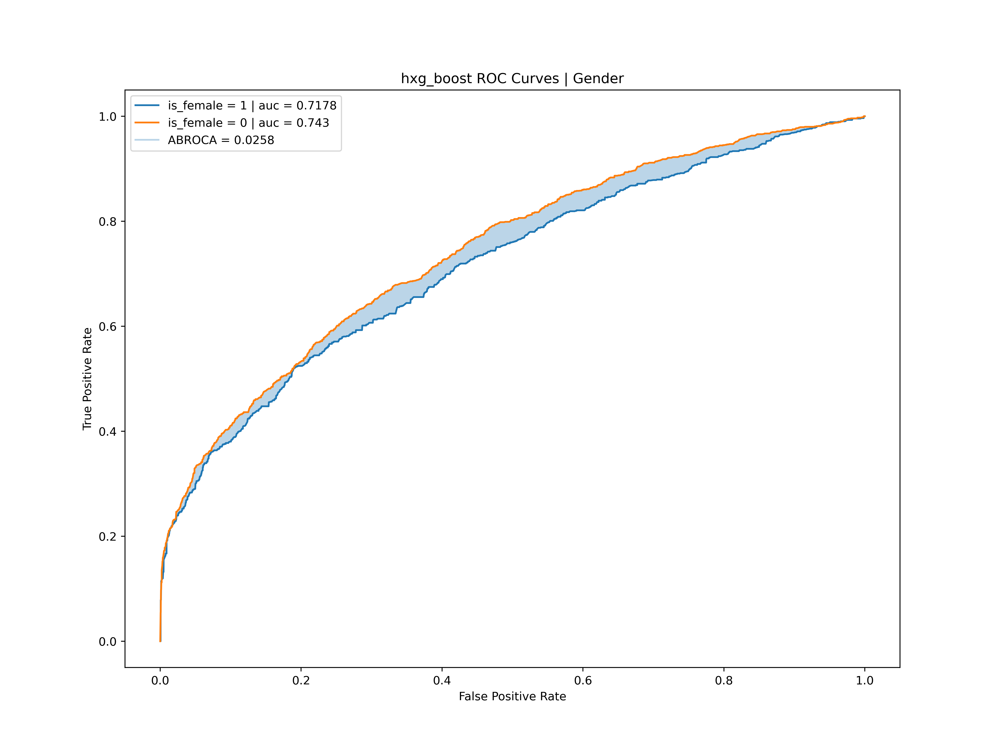

In [18]:
Image(figures / "hxg_boost_abroca_is_female_demo.png", **full_wh)

- To calculate:
    - Split dataset by feature of interest
    - Calculate ROC curves for the model on each part of split dataset
    - Sum absolute values of between-curve area
- How does this relate to fairness?
    - A model that predicts subgroups of split dataset equally would have ABROCA = 0 (Same ROC curves, so no area between)
    - Hypothesis - Higher ABROCA associated with lower predictive fairness

## Dataset

### The Open University
- Exclusively online university
- Largest university by enrollment in UK
- Provision one of the largest public learning analytics datasets

### The files
- <a href="https://analyse.kmi.open.ac.uk/open_dataset">Open University Learning Analytics Dataset (OULAD)</a>
    - <a href="http://arx.deidentifier.org/">Anonymized using ARX anonymization tool</a>
- Massive Open Online Courses (MOOCs)
    - 2 years (2013 & 2014)
    - 7 courses
    - 23 presentations
    - 32,593 students
    - 10,655,280 aggregated Virtual Learning Environment (VLE) activity records

- For course to be included in OULAD
    - The number of students in the selected module-presentation is larger than 500.
    - At least two presentations of the module exist.
    - VLE data are available for the module-presentation (since not all the modules are studied via VLE).
    - The module has a significant number of failing students.
- (clicks/student/activity/course/day)

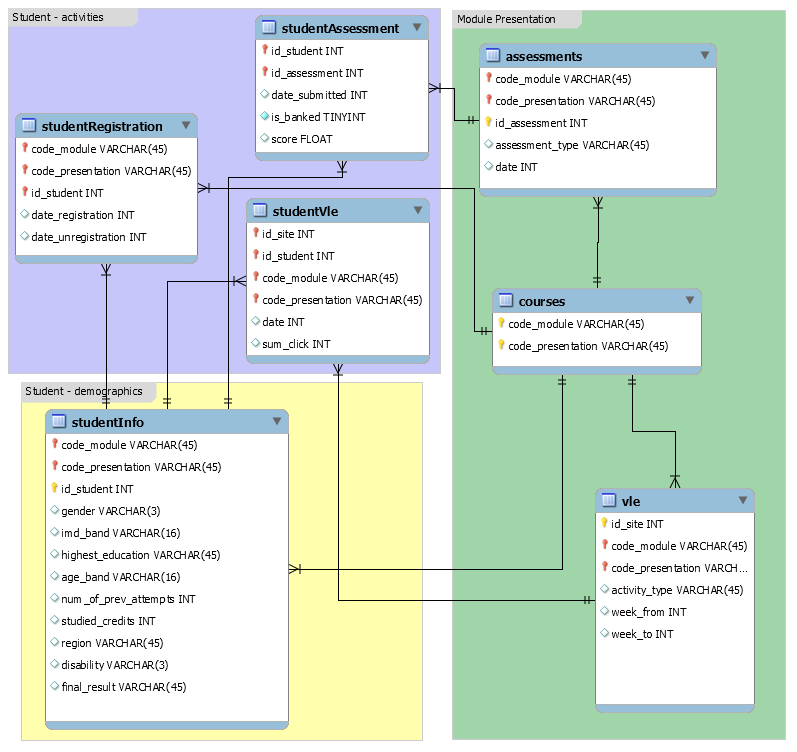

In [19]:
Image(figures / "raw_model.png", width=600, height=600)

- 7 Tables
    - Course Info
    - Student Info
    - Assessment Info
    - Virtual Learning Environment (VLE) Summaries
        - (clicks per day, per resource, per student)
    - 3 Bridge Tables

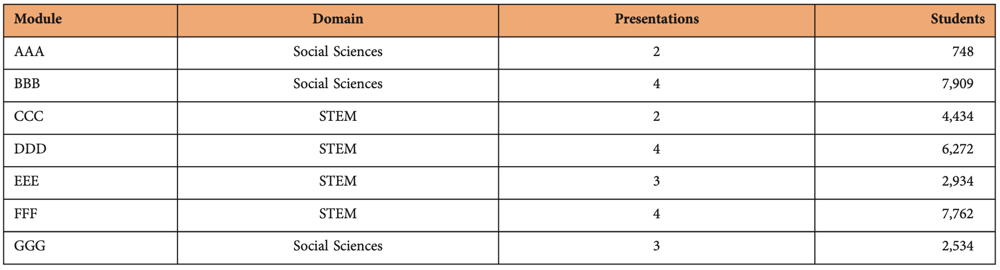

In [20]:
Image(figures / "oulad_students_courses.png", **full_wh)

can add course level details as notes

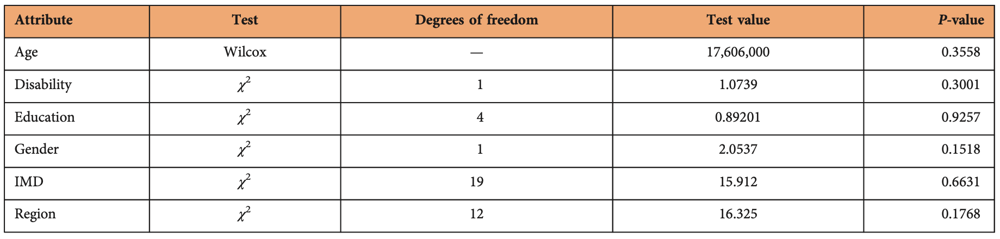

In [21]:
Image(figures / "oulad_vs_15.png", **full_wh)

compared 2013 & 2014 data with sample from 2015 to see if significant changes in deomgraphics
at a significance level of 0.05, none would be rejected

### Age (age_band)

OULAD (Red & 2013-2014), vs 2015 data (Blue)


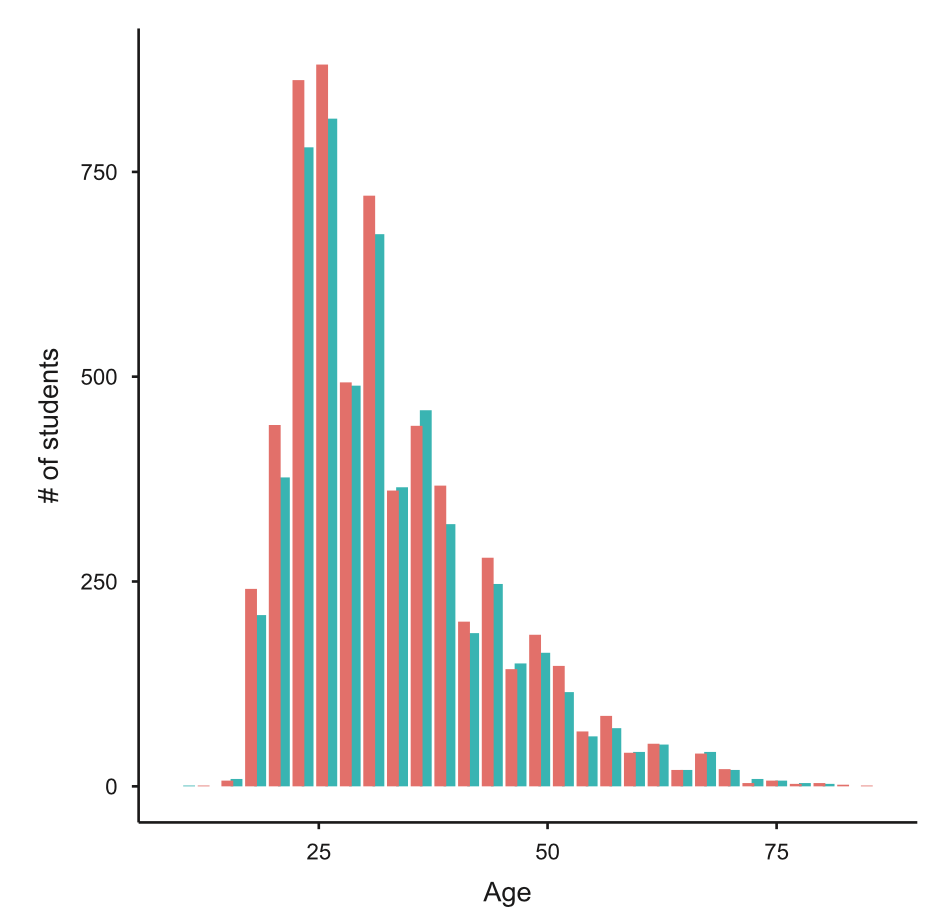

In [22]:
print("OULAD (Red & 2013-2014), vs 2015 data (Blue)")
Image(figures / "oulad_15_age.png", **demog_wh)

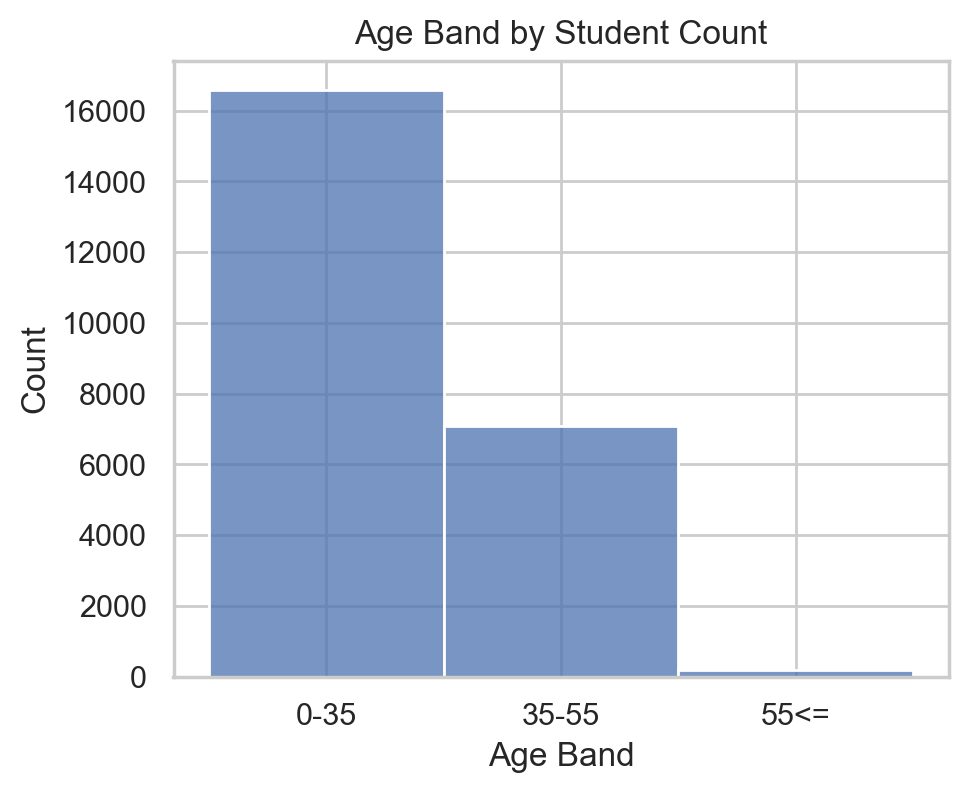

In [23]:
Image(figures / "age_band_by_student.png", **demog_wh)

In [24]:
print("part of effort to anonymize data - big bins")
features.cols["age_band"].desc(show_props=True, show_nulls=True, show_series_desc=True)

part of effort to anonymize data - big bins
Describing first30.all_features.age_band

Proportions:
    value  frequency  proportion
0   0-35      16590    0.694956
1  35-55       7091    0.297043
2   55<=        191    0.008001 

Null count: 0
count     23872
unique        3
top        0-35
freq      16590
Name: age_band, dtype: object 



### Index of Multiple Deprivation (imd_band)

Example Map of IMD


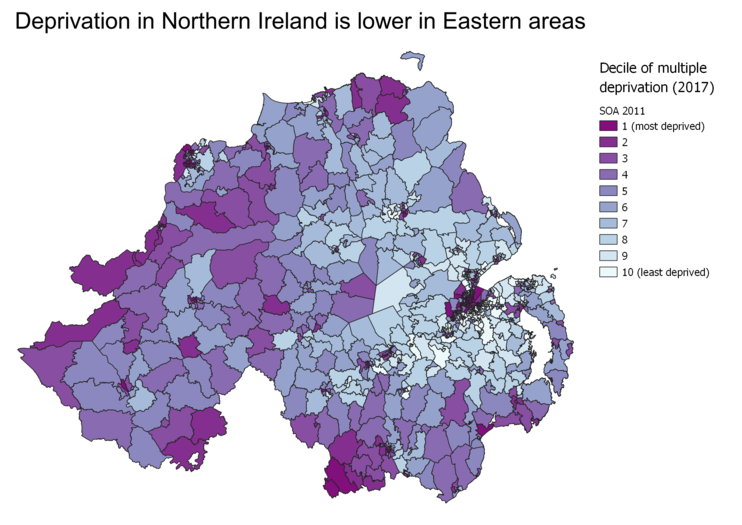

In [25]:
print("Example Map of IMD")
Image(figures / "imd.png", **demog_wh)

In the current English Indices of Deprivation 2019 (IoD2019) seven domains of deprivation are considered and weighted as follows,
- Income. (22.5%)
- Employment. (22.5%)
- Education. (13.5%)
- Health. (13.5%)
- Crime. (9.3%)
- Barriers to Housing and Services. (9.3%)
- Living Environment. (9.3%)

OULAD (Red & 2013-2014), vs 2015 data (Blue)


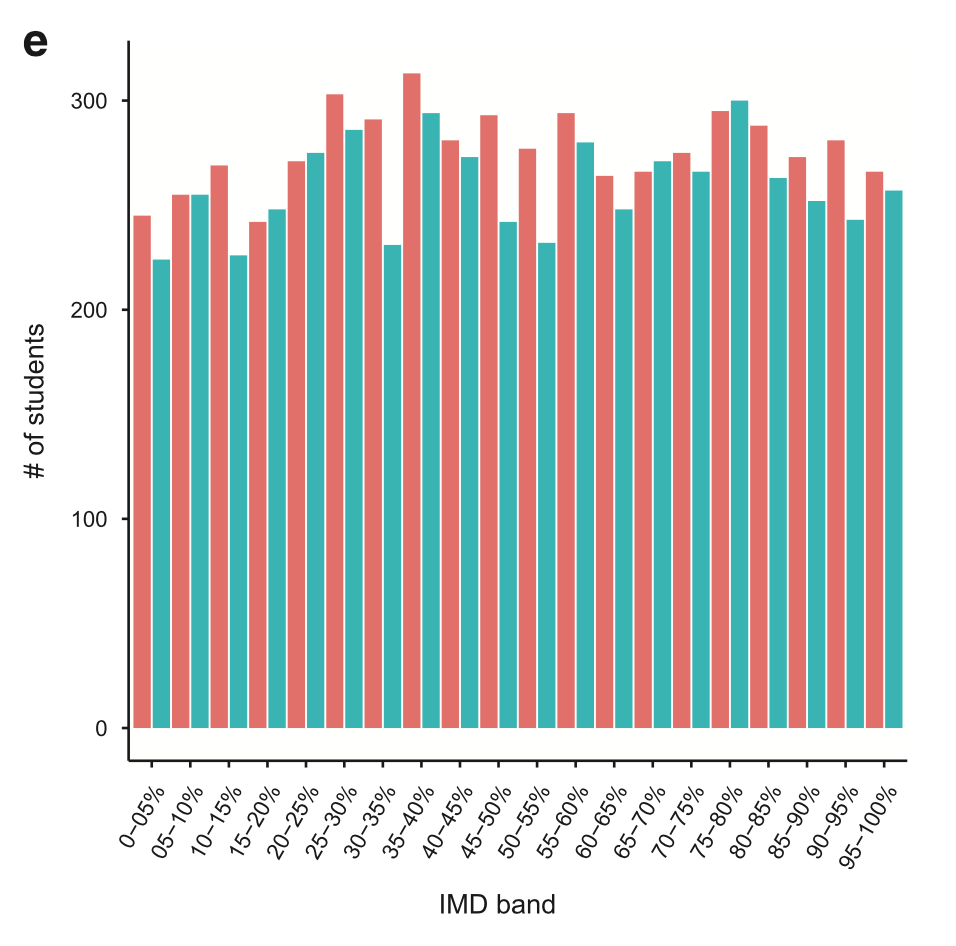

In [26]:
print("OULAD (Red & 2013-2014), vs 2015 data (Blue)")
Image(figures / "oulad_15_imd.png", **demog_wh)

lower = more deprived
maybe update data hists to combine

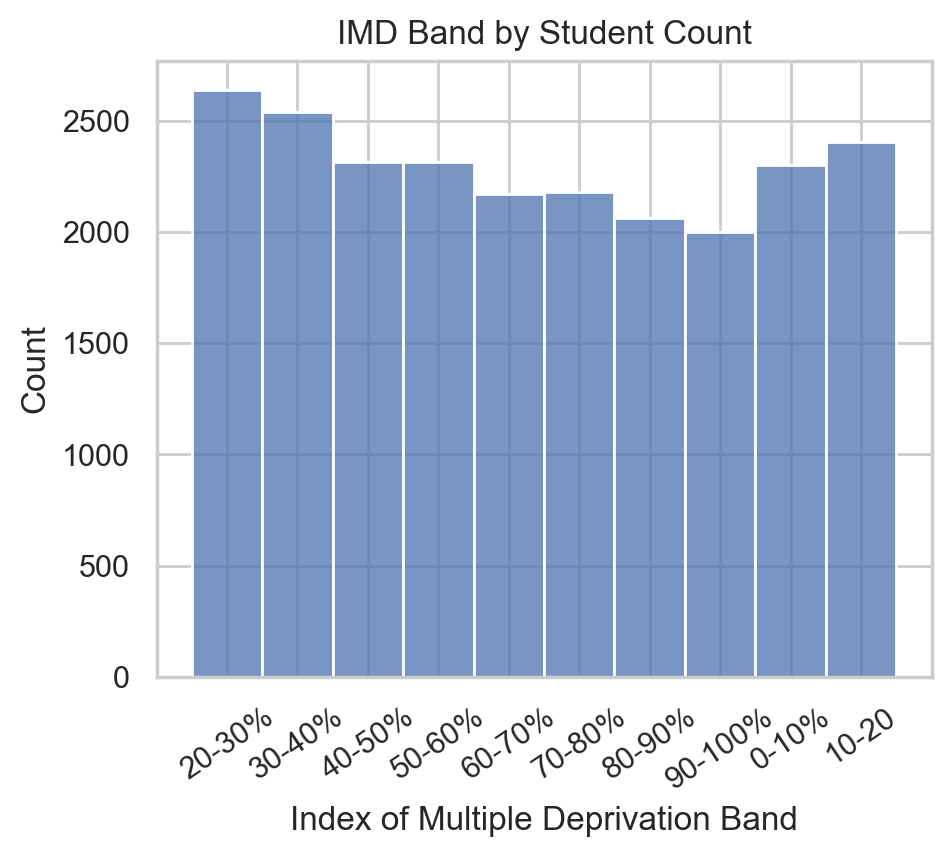

In [27]:
Image(figures / "imd_band_by_student.png", **demog_wh)

In [28]:
features.cols["imd_band"].desc(show_series_desc=True, show_props=True, show_nulls=True)

Describing first30.all_features.imd_band

Proportions:
       value  frequency  proportion
0    20-30%       2639    0.110548
1    30-40%       2539    0.106359
2    40-50%       2314    0.096934
3    50-60%       2316    0.097017
4    60-70%       2171    0.090943
5    70-80%       2180    0.091320
6    80-90%       2063    0.086419
7   90-100%       2001    0.083822
8      None          0    0.000000
9     0-10%       2303    0.096473
10    10-20       2406    0.100788 

Null count: 940
count      22932
unique        10
top       20-30%
freq        2639
Name: imd_band, dtype: object 



### Region (region)

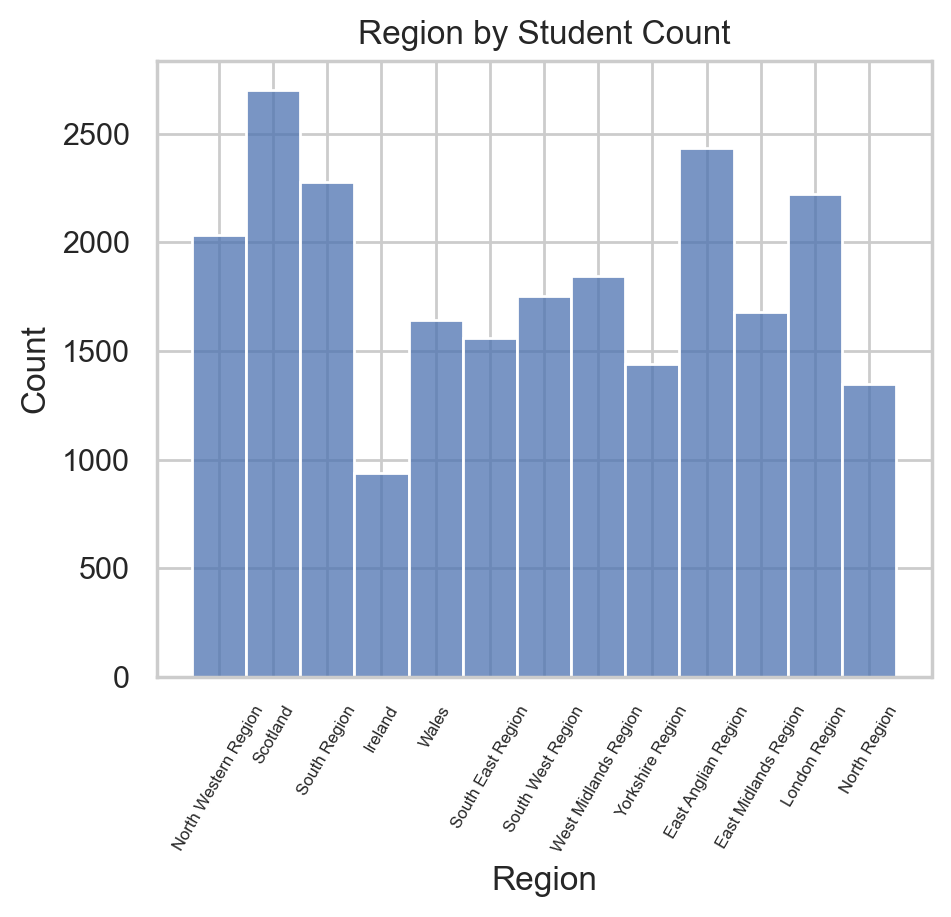

In [29]:
Image(figures / "region_by_student.png", **demog_wh)

In [30]:
features.cols["region"].desc(show_series_desc=True, show_props=True, show_nulls=True)

Describing first30.all_features.region

Proportions:
                    value  frequency  proportion
0   North Western Region       2032    0.085121
1               Scotland       2701    0.113145
2           South Region       2278    0.095426
3                Ireland        938    0.039293
4                  Wales       1642    0.068784
5      South East Region       1559    0.065307
6      South West Region       1753    0.073433
7   West Midlands Region       1845    0.077287
8       Yorkshire Region       1440    0.060322
9    East Anglian Region       2434    0.101960
10  East Midlands Region       1680    0.070375
11         London Region       2223    0.093122
12          North Region       1347    0.056426 

Null count: 0
count        23872
unique          13
top       Scotland
freq          2701
Name: region, dtype: object 



### Highest Education

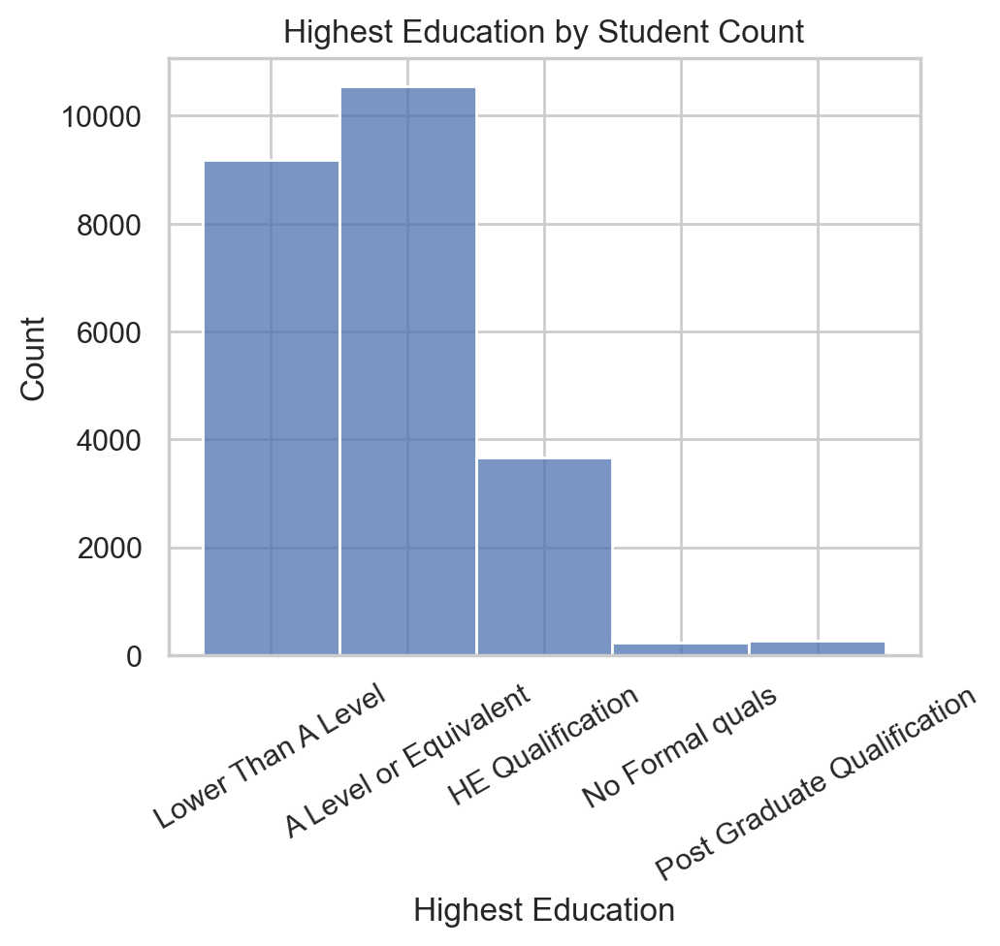

In [31]:
Image(figures / "highest_education_by_student.png", **demog_wh)

In [32]:
features.cols["highest_education"].desc(
    show_series_desc=True, show_props=True, show_nulls=True
)

Describing first30.all_features.highest_education

Proportions:
                          value  frequency  proportion
0           Lower Than A Level       9187    0.384844
1        A Level or Equivalent      10541    0.441563
2             HE Qualification       3660    0.153318
3              No Formal quals        225    0.009425
4  Post Graduate Qualification        259    0.010850 

Null count: 0
count                     23872
unique                        5
top       A Level or Equivalent
freq                      10541
Name: highest_education, dtype: object 



### Course Domain
- STEM or Social Studies

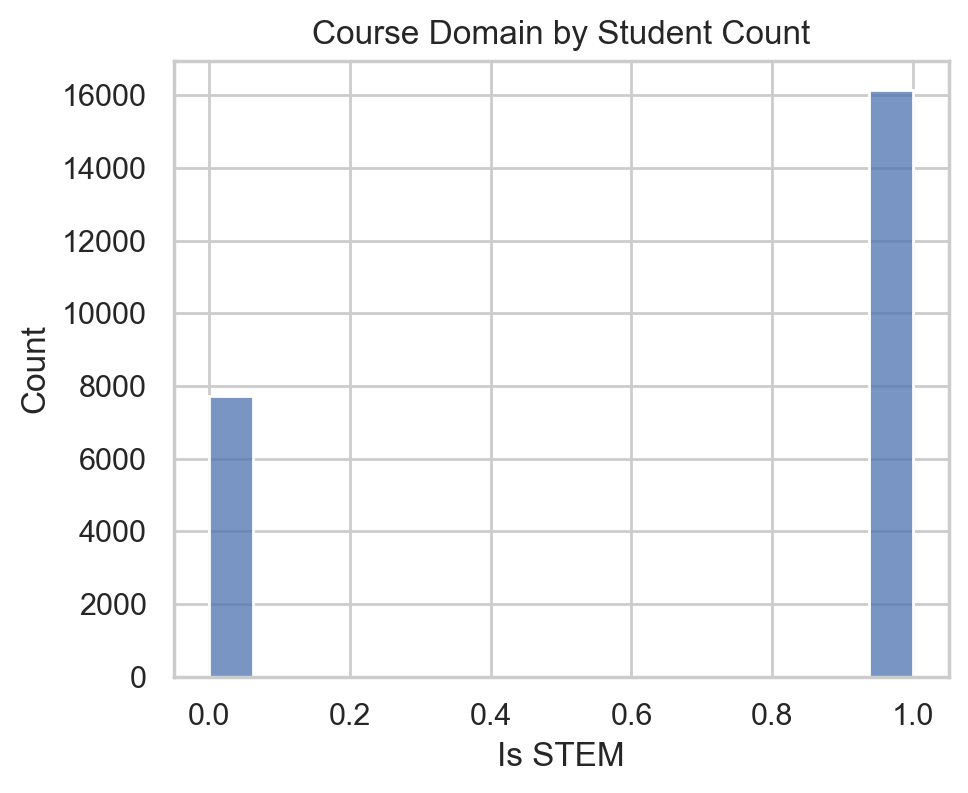

In [33]:
Image(figures / "course_domain_by_student.png", **demog_wh)

In [34]:
features.cols["is_stem"].desc(show_series_desc=True, show_props=True, show_nulls=True)

Describing first30.all_features.is_stem

Proportions:
    value  frequency  proportion
0      1      16147    0.676399
1      0       7725    0.323601 

Null count: 0
count    23872.000000
mean         0.676399
std          0.467860
min          0.000000
25%          0.000000
50%          1.000000
75%          1.000000
max          1.000000
Name: is_stem, dtype: float64 



### Final Result

In [35]:
# compare_cols = ["final_result", "is_female", "highest_education", "region"]
# first30_df = dbh.run_pd_query("select final_result, is_female, highest_education, region, student_id from first30.all_features")
# first30_gb = first30_df.groupby(compare_cols).count()
##first30_props = first30_gb.values / len(first30_df)
##first30_propdf = pd.DataFrame(first30_props, columns=first30_gb.columns, index=first30_gb.index)
# first30_gb = first30_gb.reset_index()
# first30_gb["source"] = "first30"
#
#
# staging_df = dbh.run_pd_query("""select s.is_female, he.highest_education, fr.final_result, r.region,  s.id student_id
# from main.student_info s
# join main.highest_education he on he.id=s.highest_education_id
# join main.final_result fr on fr.id=s.final_result_id
# join main.regions r on r.id=s.region_id
# """)
# staging_gb = staging_df.groupby(compare_cols).count()
##staging_props = staging_gb.values / len(first30_df)
##staging_propdf = pd.DataFrame(staging_props, columns=staging_gb.columns, index=staging_gb.index)
# staging_gb = staging_gb.reset_index()
# staging_gb["source"] = "staging"


In [36]:
# fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16,9))
# df = pd.concat([first30_gb, staging_gb])
# fg = sns.FacetGrid(df,
#              row="source",
#              col="highest_education",
#            )
# fg.map_dataframe(sns.histplot, x="highest_education", y="student_id")

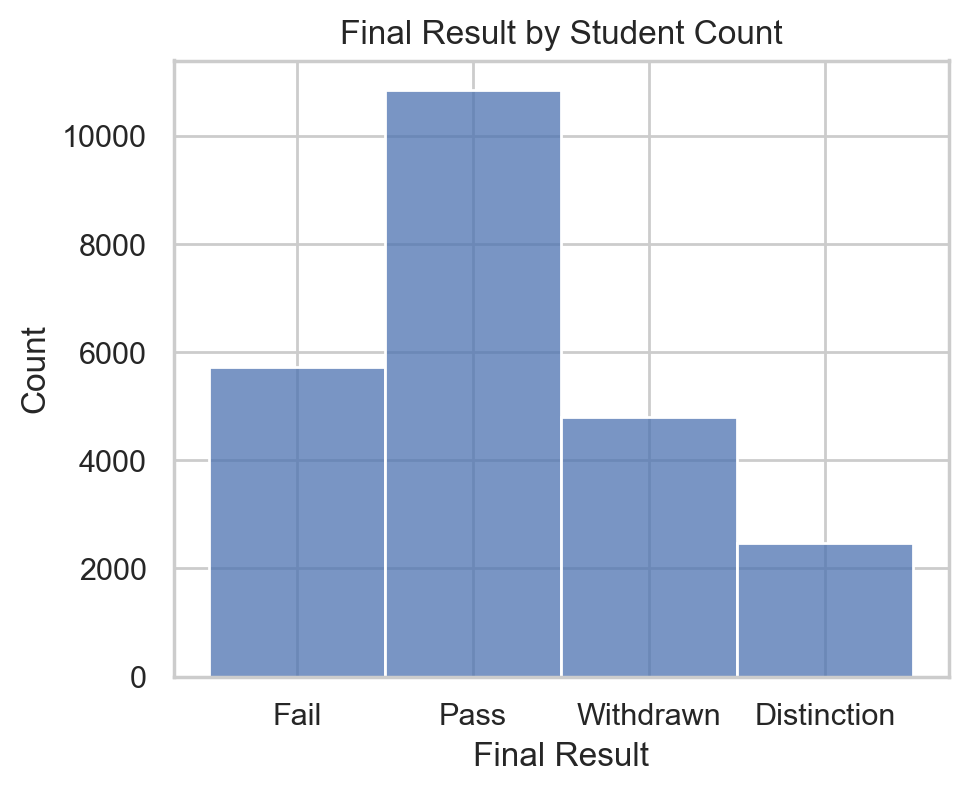

In [37]:
Image(figures / "final_result_by_student.png", **demog_wh)

In [38]:
features.cols["final_result"].desc(
    show_series_desc=True, show_props=True, show_nulls=True
)

Describing first30.all_features.final_result

Proportions:
          value  frequency  proportion
0         Fail       5728    0.239946
1         Pass      10857    0.454801
2    Withdrawn       4811    0.201533
3  Distinction       2476    0.103720 

Null count: 0
count     23872
unique        4
top        Pass
freq      10857
Name: final_result, dtype: object 



# Experimental Architecture

### Data Processing/Analysis

### Initial Database Schemas
- PostgresQL
- Landing
    - Raw CSV load
- Staging
    - Datatype and naming standardization
- Main
    - Data architecture optimization
    - Categorical/text columns stored in tables linked with integer foreign keys
    - Joined data saved in views 

In [39]:
df = (
    dbh.info_schema[(dbh.info_schema.loc[:, "table_name"] == "studentInfo")]
    .groupby(["table_schema", "table_name", "data_type"])
    .max()
)
df.loc[:, [x for x in df.columns if ("numeric" in x or "length" in x)]]

character_maximum_length  \
table_schema table_name  data_type                                     
landing      studentInfo bigint                                  NaN   
                         text                                    NaN   
staging      studentInfo bit                                     1.0   
                         character varying                      27.0   
                         integer                                 NaN   

                                            numeric_precision  numeric_scale  
table_schema table_name  data_type                                            
landing      studentInfo bigint                          64.0            0.0  
                         text                             NaN            NaN  
staging      studentInfo bit                              NaN            NaN  
                         character varying                NaN            NaN  
                         integer                         32.0            0.0

In [40]:
show_tbl('''"landing"''', '''"studentInfo"''')

Showing 10 rows from "landing"."studentInfo"


,code_module,code_presentation,id_student,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,studied_credits,disability,final_result
0,AAA,2013J,11391,M,East Anglian Region,HE Qualification,90-100%,55<=,0,240,N,Pass
1,AAA,2013J,28400,F,Scotland,HE Qualification,20-30%,35-55,0,60,N,Pass
2,AAA,2013J,30268,F,North Western Region,A Level or Equivalent,30-40%,35-55,0,60,Y,Withdrawn
3,AAA,2013J,31604,F,South East Region,A Level or Equivalent,50-60%,35-55,0,60,N,Pass
4,AAA,2013J,32885,F,West Midlands Region,Lower Than A Level,50-60%,0-35,0,60,N,Pass
5,AAA,2013J,38053,M,Wales,A Level or Equivalent,80-90%,35-55,0,60,N,Pass
6,AAA,2013J,45462,M,Scotland,HE Qualification,30-40%,0-35,0,60,N,Pass
7,AAA,2013J,45642,F,North Western Region,A Level or Equivalent,90-100%,0-35,0,120,N,Pass
8,AAA,2013J,52130,F,East Anglian Region,A Level or Equivalent,70-80%,0-35,0,90,N,Pass
9,AAA,2013J,53025,M,North Region,Post Graduate Qualification,None,55<=,0,60,N,Pass


- Landing
    - Raw CSV load
    - so much text
    - 3 columns for unique row
- Staging
    - Datatype and naming standardization
- Main [Maybe ERD]
    - Data architecture optimization
    - Categorical/text columns stored in tables linked with integer foreign keys
    - Joined data saved in views 

In [41]:
show_tbl("main", "student_info")

Showing 10 rows from main.student_info


,id,orig_student_id,course_id,module_id,presentation_id,age_band_id,imd_band_id,highest_education_id,region_id,final_result_id,is_female,has_disability,date_registration,date_unregistration,studied_credits,num_of_prev_attempts
0,32588,3733,10,4,2,3,10,2,9,4,0,0,-68,-8.0,60,0
1,22291,6516,2,1,4,3,9,2,7,3,0,0,-52,NaN,60,0
2,32538,8462,9,4,4,3,4,2,4,4,0,0,-38,18.0,60,1
3,32539,8462,10,4,2,3,4,2,4,4,0,0,-137,119.0,90,0
4,22281,11391,1,1,2,3,10,2,1,3,0,0,-159,NaN,240,0
5,4461,23629,4,2,1,1,3,3,1,2,1,0,-47,NaN,60,2
6,26116,23632,3,2,2,1,5,1,1,4,1,0,-194,-51.0,60,0
7,14301,23698,7,3,4,1,6,1,1,3,1,0,-110,NaN,120,0
8,994,23798,3,2,2,1,6,1,11,1,0,0,-27,NaN,60,0
9,11595,24186,20,7,3,1,2,3,13,3,1,1,-25,NaN,30,0


- Landing
    - Raw CSV load
- Staging
    - Datatype and naming standardization
- Main [Maybe ERD]
    - Data architecture optimization
    - Categorical/text columns stored in tables linked with integer foreign keys
    - Joined data saved in views 
    - all ints or floats

In [42]:
# fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,8))
# df = dbh.get_table("agg", "course_activities_by_popularity")
# df = df[df.loc[:, "activity_type"].apply(lambda x: x not in  ["homepage", "forumng"])]
# plot = sns.scatterplot(df,
#                 #x="top_course_activity_by_visits",
#                 #y="top_course_activity_by_clicks",
#                 x="n_visits",
#                 y="n_clicks",
#                 ax=ax,
#                 hue="activity_type",
#                 alpha=0.75,
#                 marker="1"
#                 )
# sns.Plot.scale()

## Feature Extraction
- Categories
    - Demographic Info
    - Course Info
    - VLE Interaction Data
    - Assignment Data

- Demographic Info
- Course Info
    - course level
    - course subject
- VLE Interaction Data
- Assignment Data
    - n assignments created/assigned
    - calculated moments about the mean for the number of days early or late students turned in assignments

- Agg
    - Aggregations and calculations
- Feat
    - First pass at organizing features/calculations for predictive models
- First30
    - Version of Feat created using first 30 days of class data
    - Excluded if withdrew before class day 30

- Agg
    - Aggregations and calculations
    - [Avg Assignment Days Early by N Days Active]
- Feat
    - First pass at organizing features/calculations for predictive models
    - [N Days Active]
    - [N Distinct Top 5th by Visits]
- First30
    - Version of Feat created using first 30 days of class data
    - Captures 49.60% of all withdrawn students
    - Captures 72.22% of students who withdrew after class started
    - Soon enough to make actionable difference to most withdrawing/failing students
    - [Final Result]
- Model
    - Logging of model execution data
- Eval
    - Organization of model analysis calculations


In [43]:
col = "n_days_active"
# sql = f"select {col}, final_result from first30.all_features"
# df = dbh.run_pd_query(sql)
# fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16,9), dpi=1200)
# sns.histplot(df,
#             x=col,
#             hue="final_result",
#             multiple="stack",
#             hue_order=["Distinction", "Pass", "Fail", "Withdrawn"],
#             ax=ax)
# plt.title("Days Active by Student Count")
# plt.xlim(0, 50)
# figsave(col, bbox_inches="tight")

In [44]:
Image(figures / f"{col}.png", **demog_wh)

example of aggregated feature

In [45]:
# Tables by Schema
# Image(figures / "tables_by_schema.png", **full_wh)

- Agg
    - Aggregations and calculations
- Feat
    - First pass at organizing features/calculations for predictive models
- First30
    - Version of Feat created using first 30 days of class data
- Model
    - Logging of model execution data
- Eval
    - Organization of model analysis calculations

In [46]:
col = "n_total_clicks_by_top_5th_clicks"
# sql = f"select {col}, final_result from first30.all_features"
# df = dbh.run_pd_query(sql)
# fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16,9), dpi=1200)
# sns.histplot(df,
#             x=col,
#             hue="final_result",
#             multiple="stack",
#             hue_order=["Distinction", "Pass", "Fail", "Withdrawn"],
#             ax=ax)
# plt.title("Total Clicks on Top 5th Popular Sites by Student Count")
# plt.xlim(0, 1000)
# figsave(col, bbox_inches="tight")

In [47]:
Image(figures / f"{col}.png", **full_wh)

example of expert-rec engineered feature

## Classification Algorithms & Hyperparameters

- Grid Search
    - Created large arrays of available hyperparameters
    - Brute-force search through combination of available hyperparameters
- Random Search 
    - Used GridSearch to limit the bounds of hyperparameter settings
    - Created random variables to represent distribution of particular hyperparamters, limited by results from GridSearch
    - Ran models where each iteration would pick from a model's available parameter combinations and distributions

first will show gridsearch then all examples will be generated randomly

In [48]:
get_params("hxg_boost", is_rand=False, n=3)

Example of GridSearch Cross-Validation for hxg_boost:
clf__learning_rate [0.1]
clf__random_state [None]


clf__learning_rate [0.01]
clf__random_state [None]


clf__learning_rate [0.001]
clf__random_state [None]




note incremental changes
random state is a way to freeze a random generator seed
only recommended during dev because of "seed optimization"

### <a href="https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html">Decision Tree</a> (dtree/DT)
- Simple decision rules are optimized from features to sort data

point out model type code and code for in visual

In [49]:
get_params("dtree")

Example of RandomizedSearch Cross-Validation for dtree:
clf__splitter ['best']
clf__random_state [None]
clf__min_samples_split [61]
clf__min_samples_leaf [8]
clf__max_features ['sqrt']
clf__max_depth [16]
clf__criterion ['log_loss']




### <a href="https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.AdaBoostClassifier.html">Ada Boost</a> (ada_boost/ADA)
- Ensemble Method
- Fits on original dataset, then creates copies which weight incorrectly classified instances more heavily in sequential cycles
- Used Decision Tree as base estimator, but can use many 

In [50]:
get_params("ada_boost")

Example of RandomizedSearch Cross-Validation for ada_boost:
clf__learning_rate [0.009607840680411647]
clf__random_state [None]




### <a href="https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.HistGradientBoostingClassifier.html">Histogram Gradient-Boosting</a> (hxg_boost/HGB)
- Similar to Ada Boost, but correction based on gradient of loss function from residuals (gradient descent)
- Dataset large enough that Histogram Gradient-Boosting Classifier much faster than Regular Gradient-Boosting Classifier
- Histograms increase training efficiency by bucketing continuous features

In [51]:
get_params("hxg_boost")

Example of RandomizedSearch Cross-Validation for hxg_boost:
clf__interaction_cst ['no_interactions']
clf__l2_regularization [0.3040953370005851]
clf__learning_rate [0.03922058903998265]
clf__max_bins [195]
clf__max_depth [45]
clf__max_iter [74]
clf__min_samples_leaf [8]
clf__random_state [None]
clf__warm_start [True]




### <a href="https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html">Random Forest</a> (rforest/RF)
- Ensemble Method
- Fits many decision trees on sub-samples of dataset, then uses averaging to boost accuracy and control over-fitting

In [52]:
get_params("rforest")

Example of RandomizedSearch Cross-Validation for rforest:
clf__bootstrap [True]
clf__criterion ['entropy']
clf__max_features ['log2']
clf__max_samples [0.12272488337757193]
clf__min_samples_leaf [5]
clf__min_samples_split [9]
clf__n_estimators [52]
clf__n_jobs [-1]
clf__oob_score [True]
clf__random_state [None]




### <a href="https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.ExtraTreesClassifier.html">Extra Trees</a> (etree/ET)
- Ensemble Method
- Fits many decision trees on sub-samples of dataset, then uses averaging to boost accuracy and control over-fitting

In [53]:
get_params("etree")

Example of RandomizedSearch Cross-Validation for etree:
clf__bootstrap [True]
clf__criterion ['gini']
clf__max_features ['sqrt']
clf__max_samples [0.1400021301694605]
clf__min_samples_leaf [9]
clf__min_samples_split [5]
clf__n_estimators [103]
clf__n_jobs [-1]
clf__oob_score [True]
clf__random_state [None]




### <a href="https://www.kaggle.com/code/hkapoor/random-forest-vs-extra-trees/notebook">Extra Trees vs Random Forest</a>
- Both construct many decision trees during execution & avg for classification/regression
- RF uses bootstrapping to sample subsets, ET by default does not
- RF looks for best split, ET randomly selects split
- ET typically will have faster fit times & lower variance, higher bias
- Performance of ET vs RF is often conditional upon feature selection/noisiness


### <a href="https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html">K-Nearest Neighbor</a> (knn/KNN)
- Calculates most likely value based on proximity to other points in numeric space    

In [54]:
get_params("knn")

Example of RandomizedSearch Cross-Validation for knn:
clf__weights ['distance']
clf__p [1]
clf__n_neighbors [4]
clf__n_jobs [-1]
clf__leaf_size [56]
clf__algorithm ['ball_tree']




### <a href="- https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html">Logistic Regression</a> (logreg/LOG)
- Calculates most likely value based on contribution of independednt variables

In [55]:
get_params("logreg")

Example of RandomizedSearch Cross-Validation for logreg:
clf__C [0.3234846473870656]
clf__penalty ['l2']
clf__random_state [None]
clf__solver ['liblinear']




### <a href="https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPClassifier.html">Multi-Layer Perceptron</a> (mlp/MLP)

- Simple (vanilla) neural network
- Consists of layers of connected nodes with activation functions
- Optimizes weights of nodes in each layer using backpropogation during training
- Last layer is output layer, which produces most likely result given trained inputs

In [56]:
get_params("mlp")

Example of RandomizedSearch Cross-Validation for mlp:
clf__activation ['logistic']
clf__alpha [0.0014749079430959996]
clf__early_stopping [False]
clf__hidden_layer_sizes [165]
clf__learning_rate ['invscaling']
clf__learning_rate_init [0.008378338921501449]
clf__max_iter [63]
clf__power_t [0.02097768921985744]
clf__random_state [None]
clf__solver ['sgd']




### <a href="https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html">Support Vector Machines (svc/SVC)</a>
- A hyperplane is optimized to best split the data into different spatial regions

In [57]:
get_params("svc")

Example of RandomizedSearch Cross-Validation for svc:
clf__C [0.08503983103378839]
clf__degree [2]
clf__gamma ['scale']
clf__kernel ['rbf']
clf__probability [True]
clf__random_state [None]




### Not Implemented
- Others considered but not implemented due to data preprocessing changes necessary/compute/memory overhead
- <a href = "https://scikit-learn.org/stable/modules/generated/sklearn.gaussian_process.GaussianProcessClassifier.html">Gaussian</a> 
    - (Blew up RAM) 
- <a href = "https://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.ComplementNB.html">Naive Bayes</a> 
    - (Would need to preprocess data differently) 
- <a href = "https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html">Gradient Boosting</a> 
    - (Histogram-Based Algorithm more efficient at this scale) 

In [58]:
get_params("compnb")

Example of RandomizedSearch Cross-Validation for compnb:
clf__alpha [0.0032502548421112333]
clf__norm [True]




## Model Pipeline

### Data Preprocessing
- Categorical Data -> One Hot
- Boolean Data -> Bit $\left( True = 1, False = 0 \right)$
- Numeric Data -> Standardized $\left( \mu = 0, \sigma = 1 \right)$
- Imputing Strategy = Constant = $0$
- Variance Threshold = $0$
- Dim Reduction = Principal Component Analysis w/ Maximum Likelihood Estimation

replaced all missing values with zeros to avoid removing important data - not always the best strategy
Standardized -> 0 mean, 1 var

### Model Training Settings
- Cross Validation Type = Repeated Stratified K Fold
- Cross Validation Splits $ = 5$
- Cross Validation Repeats $ = 2$
- Runs per Model $ = 10$
- Refit Parameter = ROC AUC
- Feature to Predict = "is_withdraw_or_fail"
- Train-Test Split Ratio = $[0.25, 0.35]$

In [59]:
df = dbh.get_table("eval", "v_all_runs_results", nrows=10)
cols = [
    x
    for x in df.columns
    if (
        "split" not in x
        and x[:4] != "inc_"
        and x != "name"
        and "_id" not in x
        and "rank" not in x
        and "timestamp" not in x
    )
]
top_10 = df.loc[:, cols]

# Model Evaluation

### Naive Averaging

In [60]:
top_10

,model_type,mean_fit_time,std_fit_time,mean_score_time,std_score_time,mean_test_roc_auc,std_test_roc_auc
0,rforest,43.546772,6.621612,0.308331,0.079489,0.773876,0.006709
1,etree,22.712446,2.100217,0.221903,0.027837,0.771116,0.004962
2,hxg_boost,8.673935,0.686707,0.297604,0.038754,0.770126,0.004659
3,mlp,13.990430,0.143472,0.077275,0.011556,0.769375,0.007105
4,hxg_boost,6.469628,1.027840,0.263747,0.042775,0.769049,0.006249
5,etree,14.824491,3.315720,0.251914,0.041687,0.767965,0.004917
6,hxg_boost,1.569689,0.177629,0.086444,0.013947,0.767947,0.005761
7,mlp,1.304684,0.044562,0.029652,0.002250,0.767719,0.008325
8,rforest,21.928703,4.551270,0.763771,0.412899,0.767640,0.005182
9,hxg_boost,1.494005,0.194275,0.075681,0.012553,0.767497,0.004604


In [61]:
# ROC AUC by Fit Time - by Model Type
Image(figures / "roc_fit_by_mtype.png", **xl_wh)

drive home the point that just sorting by average is very limiting

## NHST

In [62]:
# Frequentist Model Comparisons
Image(figures / "freq_window_20_16_top_100.png", **full_wh)

- Significance Value = 0.05
- recall used non parametric friedman test to check for global difference then used pairwise nemenyi

## Bayesian

In [63]:
# Bayesian Model Comparisons
Image(figures / "bayes_window_20_16_top_100.png", **full_wh)

- remem used bayesian signed rank test top check for rope (in this case, rope = 0.002)
- models using all features made better predictions than those with one category or more
- (this study got those results, another found just assignment data better)

## ABROCA

In [64]:
Image(figures / "abroca_logreg_271_0_etree_358_0_.png", **xl_wh)

- compares the ABROCA performance of two models
- two models = logreg and etree
- for this run, etree has on avg better predictive performance
    - follows previous research - more data, better predictions
- on abroca, similar for disability, logreg better on gender balance
- future - baycomp on abroca as metric to analyze

In [65]:
Image(figures / "abroca_by_gender_dis.png", **full_wh)

- follows research -> weak/no relationship between ABROCA and performance (measured by ROC AUC)
- follows research -> quadratic relationship between ABROCA & demographic balance
- (not necessary to sacrifice predictive performance while researching model fairness)
- makes sense because metric modulated is 2D area
- & models can be expected to perform worse with less training data

## Future Research
- More comprehensive metric evaulation of ABROCA
    - Statistics
    - Other demographic characteristics
- Refinement of feature extraction
- Automated optimization/analysis of hyperparamter probability distributions
- Explore relationship between mathematical properties of ROC & ABROCA
- Expend more computing resources on hierarchical comparisons rather than different parameterizations 

# Wrap Up

## Questions?

## Tools Used

Scripting Language of Choice


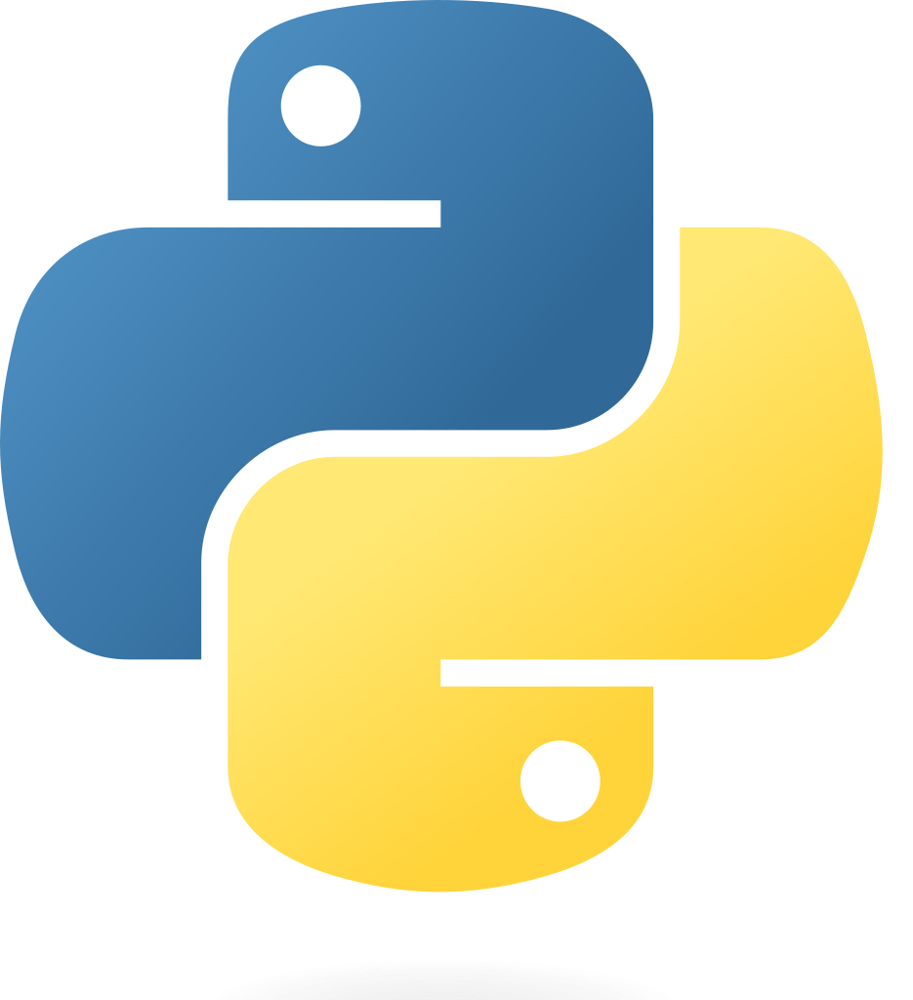

In [66]:
print("Scripting Language of Choice")

Image(logos / "python.png", **logo_wh)

Notebook Engine


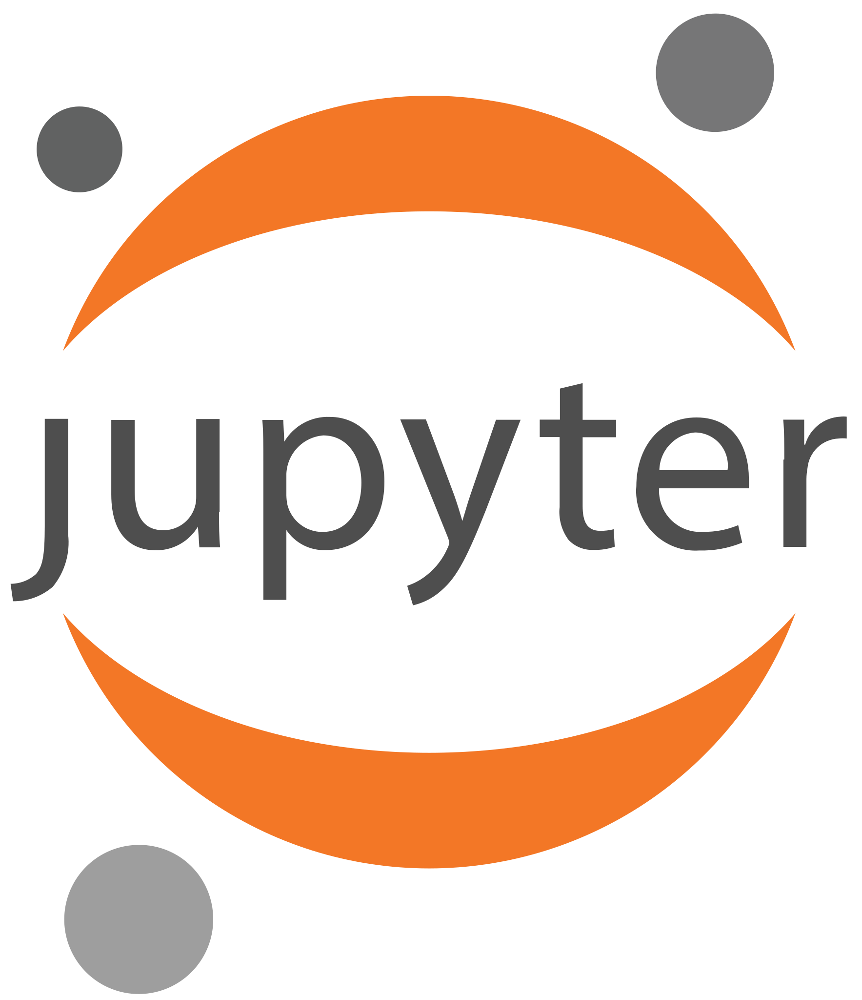

In [67]:
print("Notebook Engine")
Image(logos / "jupyter.png", **logo_wh)

Database System


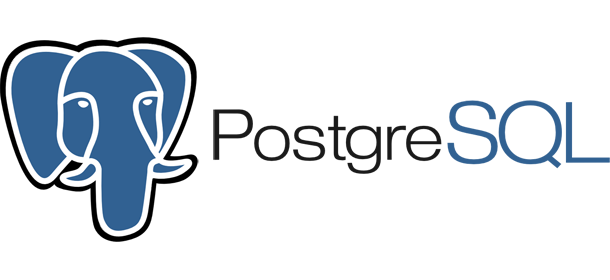

In [68]:
print("Database System")
Image(logos / "postgresql.png", **logo_wh)

Database Communication


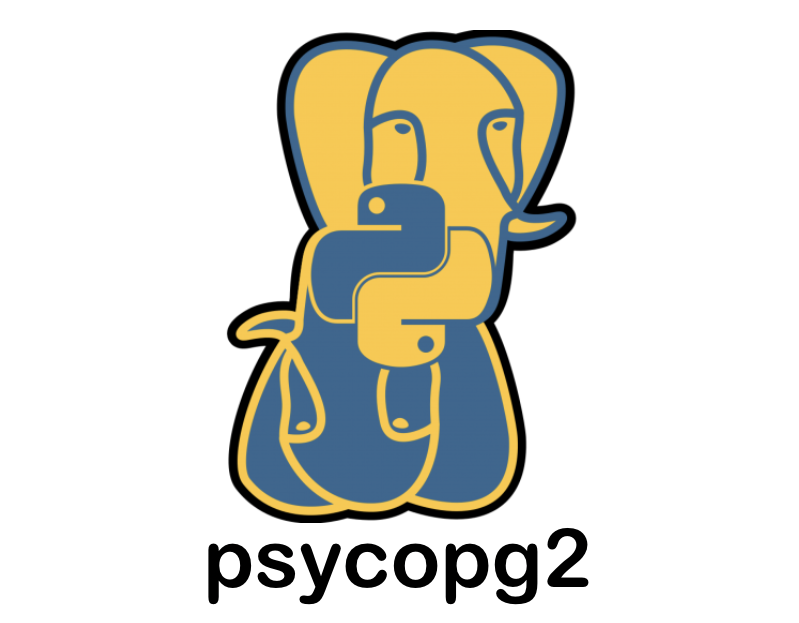

In [69]:
print("Database Communication")

Image(logos / "psycopg2.png", **logo_wh)

Database Communication & Data Manipulation


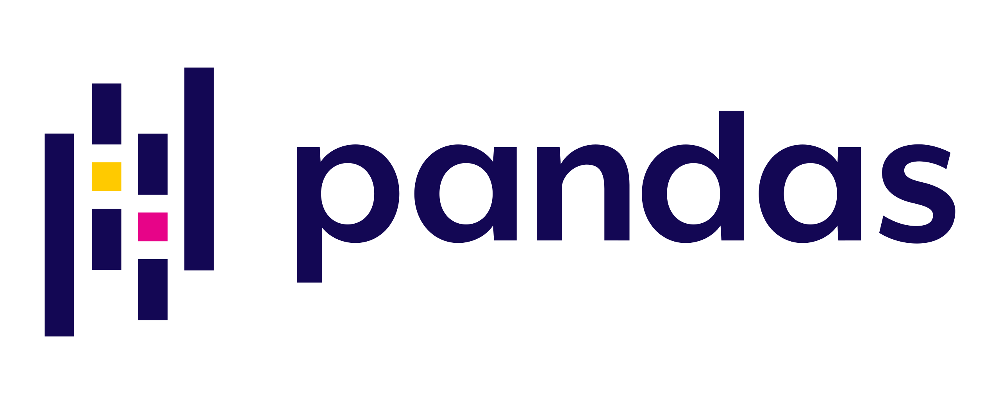

In [70]:
print("Database Communication & Data Manipulation")

Image(logos / "pandas.png", **logo_wh)

Visualizations


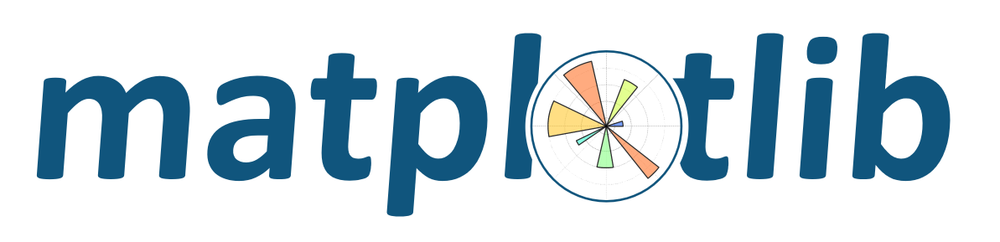

In [71]:
print("Visualizations")

Image(logos / "matplotlib.png", **logo_wh)

Visualizations


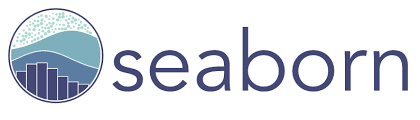

In [72]:
print("Visualizations")

Image(logos / "seaborn.png", **logo_wh)

Array Computation


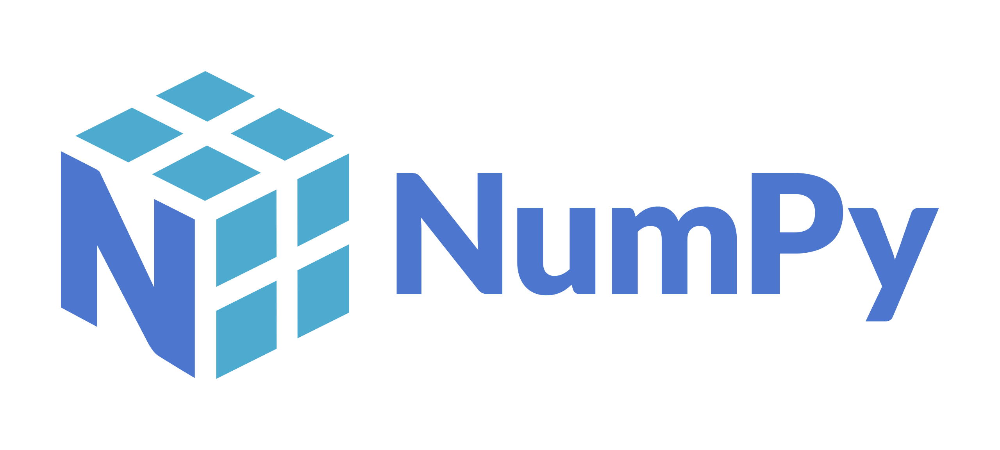

In [73]:
print("Array Computation")

Image(logos / "numpy.png", **logo_wh)

Bayesian Statistical Tests

# <a href="https://baycomp.readthedocs.io/en/latest/index.html">baycomp</a>
by:
- Janez Demsar
- Alessio Benavoli
- Giorgio Corani

Random Variables & Statistical Tests


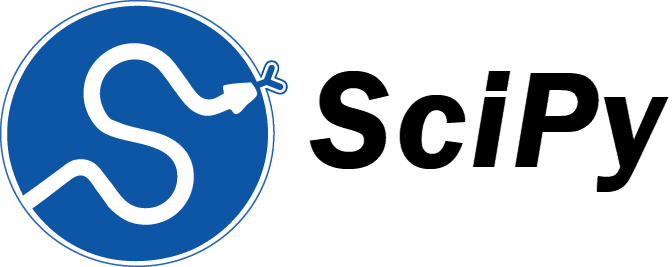

In [74]:
print("Random Variables & Statistical Tests")

Image(logos / "scipy.png", **logo_wh)

Machine Learning Models & Components


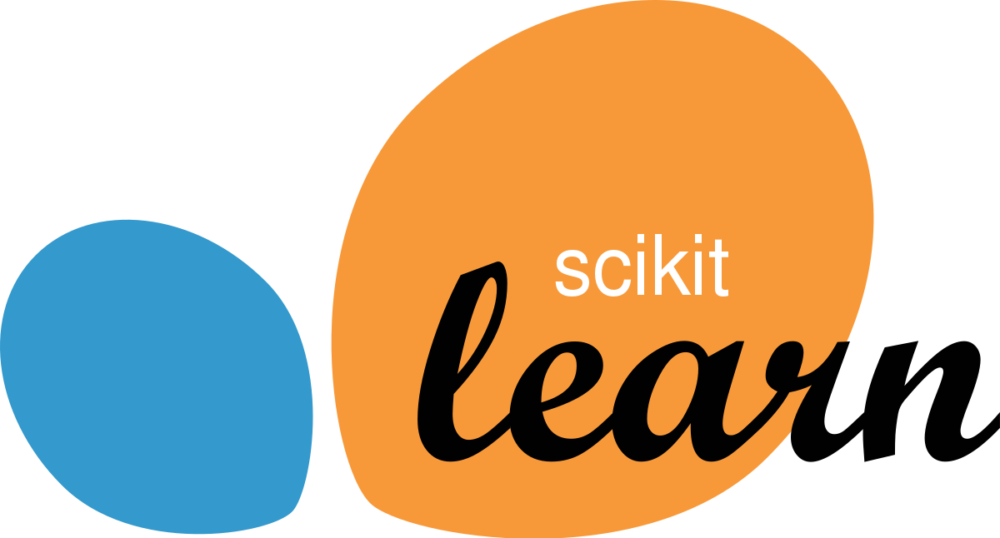

In [75]:
print("Machine Learning Models & Components")

Image(logos / "scikit-learn.png", **logo_wh)

## Top References
- <a href="https://arxiv.org/pdf/1606.04316">Time for a Change: a Tutorial for Comparing Multiple Classifiers Through Bayesian Analysis</a>
- <a href="http://doi.org/10.1145/3303772.3303791">Evaluating the Fairness of Predictive Student Models Through Slicing Analysis</a>
- <a href="http://dx.doi.org/10.18608/jla.2018.52.7">Evaluating Predictive Models of Student Success: Closing the Methodological Gap</a>
- <a href="http://dx.doi.org/10.18608/jla.2015.22.13">Exploring the Link between Online Behaviours and Course Performance in Asynchronous Online High School Courses</a>
- <a href="https://wires.onlinelibrary.wiley.com/doi/10.1002/widm.1355">Educational data mining and learning analytics: An updated survey</a>
